In [ ]:
from astropy.io import fits 
import matplotlib.pyplot as plt 
import numpy as np 

In [ ]:
GOOGLE_DRIVE = '/content/google_drive'
from google.colab import drive
drive.mount(GOOGLE_DRIVE)


import pandas as pd
path = GOOGLE_DRIVE+"/MyDrive/taller2_solar"

Drive already mounted at /content/google_drive; to attempt to forcibly remount, call drive.mount("/content/google_drive", force_remount=True).


In [ ]:
datacube = fits.open(path+"/6300_synth.fits")
datacube.info()

Filename: /content/google_drive/MyDrive/taller2_solar/6300_synth.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU       8   (131, 4, 288, 288)   float64   
  1                1 ImageHDU         6   (131,)   float64   


#Punto 1

Problem 1: In this problem we want to test ”the other” modulation scheme, that uses the linear polarizer and a rotating wave-plate. Going back and following Valentin’s slides (Lecture 10, slides 64+), calculate the modulation matrix for this approach and show that the numbers he quotes in the lecture are indeed correct. (E.g. polarimetric efficiencies).Illustrate the modulation demodulation approach in a similar way we did in class.(I.e. the modulation, followed by an appropriate demodulation).



Cargamos los datos de los parámetros de Stokes y longitudes de onda.

In [ ]:
stokes = datacube[0].data
wavelength = datacube[1].data
nl = len(wavelength)
wavelength.shape

(131,)

Re-escalamos la imagen correspondiente a las medidas solares

In [ ]:
pixel_size = 20E5 # tamaño de pixel en cm 
D = 4E2 #diametro de telescopio en cm
au = 150E11 # unidades astronomicas en centrimetros
dlambda = (wavelength[1] - wavelength[0]) * 1E-8 # delta de longitud de onda
t_exposure = 1.0

E_photon = 6.626E-27 * 2.997E10 / 6300.0E-8

scaling = pixel_size ** 2.0 * (D*0.5)**2.0 * np.pi / au ** 2.0 * dlambda * t_exposure / E_photon
stokes *= scaling

Tomamos un pixel

In [ ]:
x_pixel = 133
y_pixel = 157

Extraemos los parametos de stokes del cubo

In [ ]:
unid = stokes[x_pixel,y_pixel,0,0]
I = stokes[x_pixel,y_pixel,0]
Q = stokes[x_pixel,y_pixel,1]
U = stokes[x_pixel,y_pixel,2]
V = stokes[x_pixel,y_pixel,3]

[]

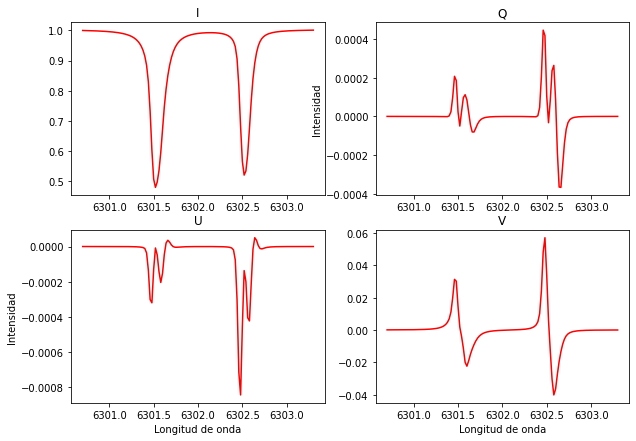

In [ ]:
plt.figure(figsize=[10,7])
plt.subplot(221)
plt.plot(wavelength,I/unid,color="r")
plt.title("I")
plt.subplot(222)
plt.plot(wavelength,Q/unid,color="r")
plt.title("Q")
plt.ylabel("Intensidad")
plt.subplot(223)
plt.plot(wavelength,U/unid,color="r")
plt.title("U")
plt.xlabel("Longitud de onda")
plt.ylabel("Intensidad")
plt.subplot(224)
plt.plot(wavelength,V/unid,color="r")
plt.title("V")
plt.xlabel("Longitud de onda")
plt.plot()

Sabemos que:

$$
\bar{S}=\mathbf{X} \bar{I}_{\odot}
$$

Donde $\mathbf{X}$ es la matrix de modulación, $\bar{I}_{\odot}$ es el vector de las intensidades medidas y $\bar{S}$ es el estado de modulación.

Podemos calcular los estados de modulacion mediante:

$$I_{D}^{+}=\frac{1}{2}\left(I_{\odot}+[(1+\cos \Delta)+\cos 4 \omega t \cdot(1-\cos \Delta)] \frac{Q_{\odot}}{2}+[\sin 4 \omega t \cdot(1-\cos \Delta)] \frac{U_{\odot}}{2}-[\sin 2 \omega t \cdot \sin \Delta] V_{\odot}\right)$$

Donde $\alpha(t) = \omega t$ es:


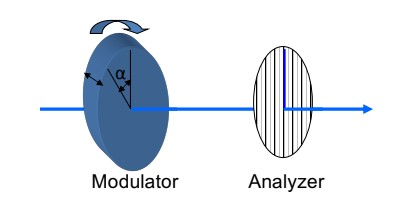



In [ ]:
def calc_modulation_row(alpha,delta):
    row = np.zeros(4)
    row[0] = 1 
    row[1] = 0.5*((1+np.cos(delta)) + (np.cos(4*alpha)*(1-np.cos(delta))))
    row[2] = 0.5 * (np.sin(4.*alpha)*(1-np.cos(delta)))
    row[3] = -(np.sin(2.*alpha) * np.sin(delta))
    row=row.reshape(1,4)
    return row

Queremos obtener la siguiente matrix:

$$
\mathbf{X}=\left[\begin{array}{cccc}
+1 & +0.71 & +0.51 & -0.30 \\
+1 & -0.31 & +0.51 & -0.72 \\
+1 & -0.31 & -0.51 & -0.72 \\
+1 & +0.71 & -0.51 & -0.30 \\
+1 & +0.71 & +0.51 & +0.30 \\
+1 & -0.31 & +0.51 & +0.72 \\
+1 & -0.31 & -0.51 & +0.72 \\
+1 & +0.71 & -0.51 & +0.30
\end{array}\right]
$$

Donde se tiene que Δ = 127$^{∘}$, por lo que tenemos que encontrar valores optimos para $\alpha$ 

In [ ]:
delta = 2.217
theta = np.linspace(0,2*np.pi,1000)

O1_,O2_,O3_,O4_,O5_,O6_,O7_,O8_ = [],[],[],[],[],[],[],[]
min1,min2,min3,min4,min5,min6,min7,min8 = 100,100,100,100,100,100,100,100
alpha = [0,0,0,0,0,0,0,0]
O8_1 = [1, 0.71, 0.51, -0.30]
O8_2 = [1, -0.31, 0.51, -0.72]
O8_3 = [1, -0.31, -0.51, -0.72]
O8_4 = [1, 0.71, -0.51, -0.30]
O8_5 = [1, 0.71, 0.51, 0.30]
O8_6 = [1, -0.31, 0.51, 0.72]
O8_7 = [1, -0.31, -0.51, 0.72]
O8_8 = [1, 0.71, -0.51, 0.30]


for the in theta:
  O1 = calc_modulation_row(the,delta)
  O2 = calc_modulation_row(the,delta)
  O3 = calc_modulation_row(the,delta)
  O4 = calc_modulation_row(the,delta)
  O5 = calc_modulation_row(the,delta)
  O6 = calc_modulation_row(the,delta)
  O7 = calc_modulation_row(the,delta)
  O8 = calc_modulation_row(the,delta)
  if(np.std(O1-O8_1)< min1):
    min1 = np.std(O1-O8_1) 
    O1_ = np.round(O1,2)
    alpha[0] = the
  if(np.std(O2-O8_2)< min2):
    min2 = np.std(O2-O8_2) 
    O2_ = np.round(O2,2)
    alpha[1] = the
  if(np.std(O3-O8_3)< min3 and O3[0][1]<0 and O3[0][2]< 0 and O3[0][3]<0):
    min3 = np.std(O3-O8_3) 
    O3_ = np.round(O3,2)
    alpha[2] = the
  if(np.std(O4-O8_4)< min4):
    min4 = np.std(O4-O8_4) 
    O4_ = np.round(O4,2)
    alpha[3] = the
  if(np.std(O5-O8_5)< min5):
    min5 = np.std(O5-O8_5) 
    O5_ = np.round(O5,2)
    alpha[4] = the
  if(np.std(O6-O8_6)< min6):
    min6 = np.std(O6-O8_6) 
    O6_ = np.round(O6,2)
    alpha[5] = the
  if(np.std(O7-O8_7)< min7):
    min7 = np.std(O7-O8_7) 
    O7_ = np.round(O7,2)
    alpha[6] = the
  if(np.std(O8-O8_8)< min8):
    min8 = np.std(O8-O8_8) 
    O8_ = np.round(O8,2)
    alpha[7] = the
  
O8 = np.concatenate((O1_,O2_,O3_,O4_,O5_,O6_,O7_,O8_),axis=0)
O8

array([[ 1.  ,  0.78,  0.56, -0.3 ],
       [ 1.  , -0.37,  0.56, -0.74],
       [ 1.  , -0.37, -0.57, -0.74],
       [ 1.  ,  0.76, -0.57, -0.31],
       [ 1.  ,  0.76,  0.57,  0.31],
       [ 1.  , -0.35,  0.58,  0.73],
       [ 1.  , -0.36, -0.58,  0.74],
       [ 1.  ,  0.77, -0.56,  0.3 ]])

Donde $\alpha$ es:

In [ ]:
alpha

[3.33342163443962,
 0.5912106295043854,
 0.9811580659860014,
 4.515842893448391,
 4.9120798047119685,
 5.295737766411623,
 5.698264152457162,
 6.088211588938778]

Visto $\alpha$ en grados

In [ ]:
np.degrees(alpha)

array([190.99099099,  33.87387387,  56.21621622, 258.73873874,
       281.44144144, 303.42342342, 326.48648649, 348.82882883])

In [ ]:
O_wrong = np.copy(O8)
O_wrong[0,0] *= 1.01 #we will only miss 1%!

#or more complicated one
O_wrong *= (1.0 + np.random.randn(32).reshape(8,4)*0.01)
I = stokes[x_pixel,y_pixel]
S_measured_8 = np.zeros([8,nl])
O8_inv = np.linalg.pinv(O8)
for l in range(0,nl):
    S_measured_8[:,l] = np.dot(O_wrong,I[:,l])

I_inferred_8 = np.zeros([4,nl])
# demodulate with the wrong one!
for l in range(0,nl):
    I_inferred_8[:,l] = np.dot(O8_inv,S_measured_8[:,l])

Veamos que la matrix de demodulacion D es:

In [ ]:
O8_inv

array([[ 0.07939306,  0.17003154,  0.16890335,  0.07983825,  0.08175307,
         0.170307  ,  0.16995434,  0.0798194 ],
       [ 0.22580699, -0.22280383, -0.21990781,  0.22090996,  0.21564441,
        -0.22058153, -0.22156186,  0.22249366],
       [ 0.21623626,  0.22043958, -0.21618535, -0.22030886,  0.21841013,
         0.22391989, -0.22429977, -0.21821188],
       [-0.1210567 , -0.28942674, -0.286201  , -0.12168076,  0.11843974,
         0.28747431,  0.29474889,  0.11770227]])

Observemos que este es un resultado muy cercano al que se obtiene en la lectura 10 para la polarizacion del retardador rotante.

Finalmente, podemos observar las intensidades ó parametros de stokes una vez realizamos la demodulación.

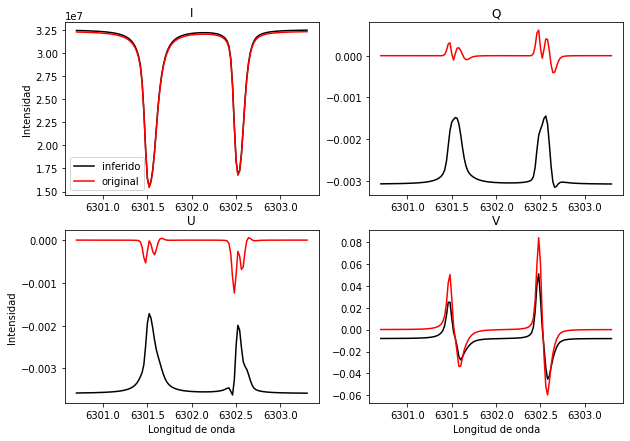

In [ ]:
# Plot :
plt.figure(figsize=[10,7])
plt.subplot(221)
plt.plot(wavelength,I_inferred_8[0],label='inferido',color="Black")
plt.plot(wavelength,I[0],label='original',color="red")
plt.ylabel("Intensidad")
plt.title("I")
plt.legend()
plt.subplot(222)
plt.plot(wavelength,I_inferred_8[1]/I_inferred_8[0,0],color="Black")
plt.plot(wavelength,I[1]/I[0],color="red")
plt.title("Q")
plt.subplot(223)
plt.plot(wavelength,I_inferred_8[2]/I_inferred_8[0,0],color="Black")
plt.plot(wavelength,I[2]/I[0],color="red")
plt.xlabel("Longitud de onda")
plt.ylabel("Intensidad")
plt.title("U")
plt.subplot(224)
plt.plot(wavelength,I_inferred_8[3]/I_inferred_8[0,0],color="Black")
plt.plot(wavelength,I[3]/I[0],color="red")
plt.xlabel("Longitud de onda")
plt.title("V")
plt.show()

Además, podemos calcular las eficiencias dadas por la ecuacion


$$
\varepsilon_{i}=\left(n \sum_{j=1}^{n} D_{i j}^{2}\right)^{-1 / 2}
$$

Donde D = X$^{-1}$

In [ ]:
# calculating efficiencies
print (1./np.sqrt(8.*np.sum(O8_inv**2.0,axis=1)))

[0.9413538  0.56502203 0.5687743  0.56430392]


Dados los resultados encontrados podemos concluir que se ha realizado la modulacion correcta para "Rotating retarder"

# Punto 2

Problem 2: Using the Stokes cube and the approach we used in the class, assuming that Q, U, and V in the original cube are zero, illustrate the effect of seeing-induced polarization by plotting wavelength dependent de-modulated Stokes profiles. How do these spurious Stokes profiles look like?

In [ ]:
stokes = datacube[0].data
wavelength = datacube[1].data
nl = len(wavelength)

In [ ]:
pixel_size = 20E5 
D = 4E2 
au = 150E11  
dlambda = (wavelength[1] - wavelength[0]) * 1E-8 
t_exposure = 1.0

E_photon = 6.626E-27 * 2.997E10 / 6300.0E-8

scaling = pixel_size ** 2.0 * (D*0.5)**2.0 * np.pi / au ** 2.0 * dlambda * t_exposure / E_photon
stokes *= scaling

In [ ]:
x_pixel = 133
y_pixel = 157

Calculamos el estado de modulacion de la forma:
$$
I_{\text {meas }}(\theta, \delta)=\frac{1}{2}(I+Q \cos 2 \theta+U \cos \delta \sin 2 \theta+V \sin \delta \sin 2 \theta)
$$

In [ ]:
def modulation_row(theta,delta):
    row = np.zeros(4)
    row[0] = 1.0
    row[1] = np.cos(2.*theta)
    row[2] = np.cos(delta)*np.sin(2.*theta)
    row[3] = np.sin(delta)*np.sin(2.*theta)
    row = row.reshape(1,4)
    return row

Ahora calculamos la matrix de modulacion de orden 6

In [ ]:
pi = np.pi
O6 = modulation_row(0,0)
O6 = np.concatenate([O6,modulation_row(pi/2,0)],axis=0)
O6 = np.concatenate([O6,modulation_row(pi/4,0)],axis=0)
O6 = np.concatenate([O6,modulation_row(3*pi/4,0)],axis=0)
O6 = np.concatenate([O6,modulation_row(pi/4,pi/2)],axis=0)
O6 = np.concatenate([O6,modulation_row(3*pi/4,pi/2)],axis=0)
O6

array([[ 1.0000000e+00,  1.0000000e+00,  0.0000000e+00,  0.0000000e+00],
       [ 1.0000000e+00, -1.0000000e+00,  1.2246468e-16,  0.0000000e+00],
       [ 1.0000000e+00,  6.1232340e-17,  1.0000000e+00,  0.0000000e+00],
       [ 1.0000000e+00, -1.8369702e-16, -1.0000000e+00, -0.0000000e+00],
       [ 1.0000000e+00,  6.1232340e-17,  6.1232340e-17,  1.0000000e+00],
       [ 1.0000000e+00, -1.8369702e-16, -6.1232340e-17, -1.0000000e+00]])

In [ ]:
O6_inv = np.linalg.pinv(O6)

La matrix de demodulación D se escribe de la forma:

In [ ]:
O6_inv

array([[ 1.66666667e-01,  1.66666667e-01,  1.66666667e-01,
         1.66666667e-01,  1.66666667e-01,  1.66666667e-01],
       [ 5.00000000e-01, -5.00000000e-01,  1.55261196e-17,
        -4.32816952e-17,  1.17851821e-16, -4.58451872e-17],
       [-3.92574231e-18, -2.08240726e-17,  5.00000000e-01,
        -5.00000000e-01,  1.15500678e-16, -4.46088589e-17],
       [ 5.62567857e-17,  1.03181215e-16, -3.23981264e-17,
        -2.31130249e-17,  5.00000000e-01, -5.00000000e-01]])

Veamos los parametros de Stokes iniciales donde Q, U, V son ceros, es decir, luz no polarizada

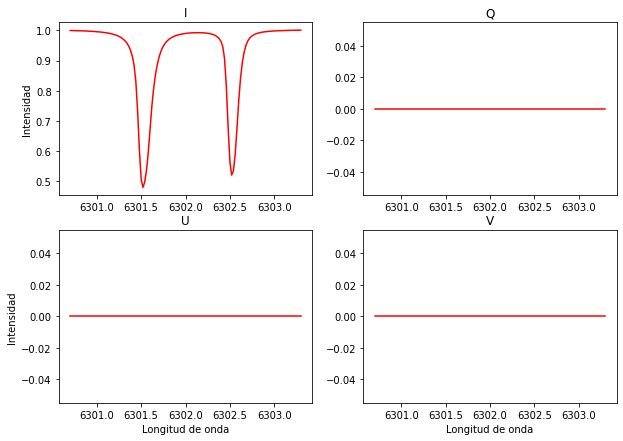

In [ ]:
I = stokes[x_pixel,y_pixel,0]
Q = np.zeros(131)
U = np.zeros(131)
V = np.zeros(131)

plt.figure(figsize=[10,7])
plt.subplot(221)
plt.plot(wavelength,I/stokes[x_pixel,y_pixel,0,0],color="red")
plt.title("I")
plt.ylabel("Intensidad")
plt.subplot(222)
plt.plot(wavelength,Q,color="r")
plt.title("Q")
plt.subplot(223)
plt.plot(wavelength,U,color="r")
plt.title("U")
plt.xlabel("Longitud de onda")
plt.ylabel("Intensidad")
plt.subplot(224)
plt.plot(wavelength,V,color="r")
plt.title("V")
plt.xlabel("Longitud de onda")
plt.show()

O visto de otra forma:

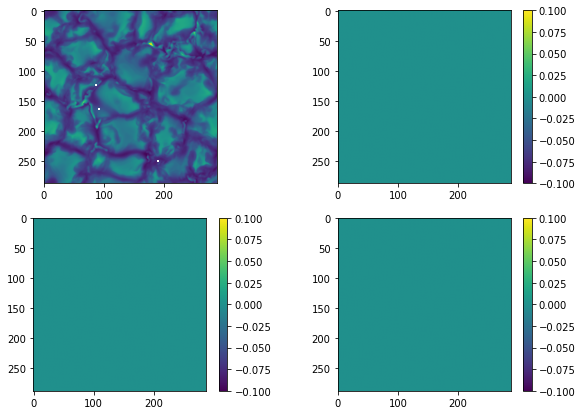

In [ ]:
I_original = stokes[:,:,:,0]
I_original[:,:,1] = np.zeros((288,288))
I_original[:,:,2] = np.zeros((288,288))
I_original[:,:,3] = np.zeros((288,288))

plt.figure(figsize=[10,7])
plt.subplot(221)
plt.imshow(I_original[:,:,0])
plt.subplot(222)
plt.imshow(I_original[:,:,1])
plt.colorbar()
plt.subplot(223)
plt.imshow(I_original[:,:,2])
plt.colorbar()
plt.subplot(224)
plt.imshow(I_original[:,:,3])
plt.colorbar()

Ahora realizamos una demodulacion para obtener los parametros de stokes inferidos, esto lo hacemos para todas las longitudes de onda realizando una rotacion en los elementos de cada parametro para cada longitud de onda 

In [ ]:
I_long = []
for n in range(0,131):
  print("--Longitud de onda ===>"+str(n+1)+"/131--")
  I_original = stokes[:,:,:,n]
  I_original[:,:,1] = np.zeros((288,288))
  I_original[:,:,2] = np.zeros((288,288))
  I_original[:,:,3] = np.zeros((288,288))

  S_measured = np.zeros([288,288,6])
  I_inferred = np.zeros([288,288,4])
  I_1 = np.roll(I_original,(1,1),axis=(0,1))
  I_2 = np.roll(I_original,(2,2),axis=(0,1))
  I_3 = np.roll(I_original,(3,3),axis=(0,1))
  I_4 = np.roll(I_original,(4,4),axis=(0,1))
  I_5 = np.roll(I_original,(5,5),axis=(0,1))
  I_6 = np.roll(I_original,(6,6),axis=(0,1))

  for i in range(0,288):
      for j in range(0,288):
          S_measured[i,j,0] = np.dot(O6[0,:],I_1[i,j,:])
          S_measured[i,j,1] = np.dot(O6[1,:],I_2[i,j,:])
          S_measured[i,j,2] = np.dot(O6[2,:],I_3[i,j,:])
          S_measured[i,j,3] = np.dot(O6[3,:],I_4[i,j,:])
          S_measured[i,j,4] = np.dot(O6[4,:],I_5[i,j,:])
          S_measured[i,j,5] = np.dot(O6[5,:],I_6[i,j,:])
          I_inferred[i,j,:] = np.dot(O6_inv,S_measured[i,j,:])
  I_long.append(I_inferred)


--Longitud de onda ===>1/131--
--Longitud de onda ===>2/131--
--Longitud de onda ===>3/131--
--Longitud de onda ===>4/131--
--Longitud de onda ===>5/131--
--Longitud de onda ===>6/131--
--Longitud de onda ===>7/131--
--Longitud de onda ===>8/131--
--Longitud de onda ===>9/131--
--Longitud de onda ===>10/131--
--Longitud de onda ===>11/131--
--Longitud de onda ===>12/131--
--Longitud de onda ===>13/131--
--Longitud de onda ===>14/131--
--Longitud de onda ===>15/131--
--Longitud de onda ===>16/131--
--Longitud de onda ===>17/131--
--Longitud de onda ===>18/131--
--Longitud de onda ===>19/131--
--Longitud de onda ===>20/131--
--Longitud de onda ===>21/131--
--Longitud de onda ===>22/131--
--Longitud de onda ===>23/131--
--Longitud de onda ===>24/131--
--Longitud de onda ===>25/131--
--Longitud de onda ===>26/131--
--Longitud de onda ===>27/131--
--Longitud de onda ===>28/131--
--Longitud de onda ===>29/131--
--Longitud de onda ===>30/131--
--Longitud de onda ===>31/131--
--Longitud de ond

In [ ]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:90% !important; }<style>"))
display(HTML("<style>.container { font-size:18px !important; }<style>"))
from matplotlib import animation, rc

#Funcion para animacion

def animacion(images,cmap="gray",origin='lower',vmin=None,vmax=None):
    # Animate
    fig = plt.figure()
    #plt.axis("off")
    ims = []
    for i in images:
        ims.append((plt.imshow(i, cmap=cmap,origin=origin,vmin=vmin,vmax=vmax),))
    animacion_salida = animation.ArtistAnimation(fig, ims, interval=100, repeat_delay=9000, blit=True)
    return animacion_salida


Veamos el resultado obtenido para los parametros de Stokes inferidos para todas las longitudes de onda 

Parametro I

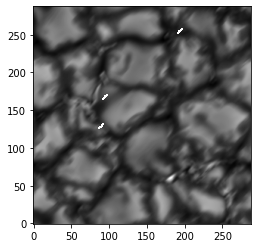

In [ ]:
Intensidad_I = [ima[:,:,0] for ima in I_long]

im_fase = animacion(Intensidad_I)
display(HTML(im_fase.to_jshtml()))

Parametro Q

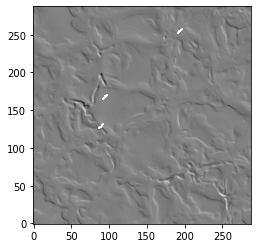

In [ ]:
Intensidad_Q = [ima[:,:,1] for ima in I_long]

im_fase_Q = animacion(Intensidad_Q)
display(HTML(im_fase_Q.to_jshtml()))

Parametro U

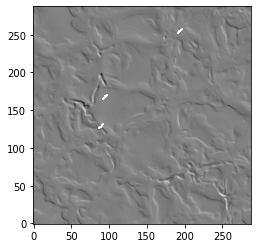

In [ ]:
Intensidad_U = [ima[:,:,2] for ima in I_long]

im_fase_U = animacion(Intensidad_Q)
display(HTML(im_fase_U.to_jshtml()))

Parametro V

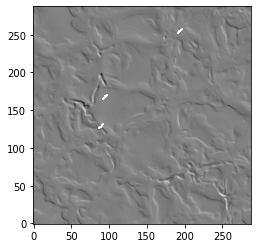

In [ ]:
Intensidad_V = [ima[:,:,3] for ima in I_long]

im_fase_V = animacion(Intensidad_Q)
display(HTML(im_fase_V.to_jshtml()))

Podemos observar por las imagenes que el parametro de Stokes no permanecio en cero para Q, V, U

In [ ]:
I_longi = [im[x_pixel,y_pixel,0] for im in I_long]
Q_longi = [im[x_pixel,y_pixel,1] for im in I_long]
U_longi = [im[x_pixel,y_pixel,2] for im in I_long]
V_longi = [im[x_pixel,y_pixel,3] for im in I_long]

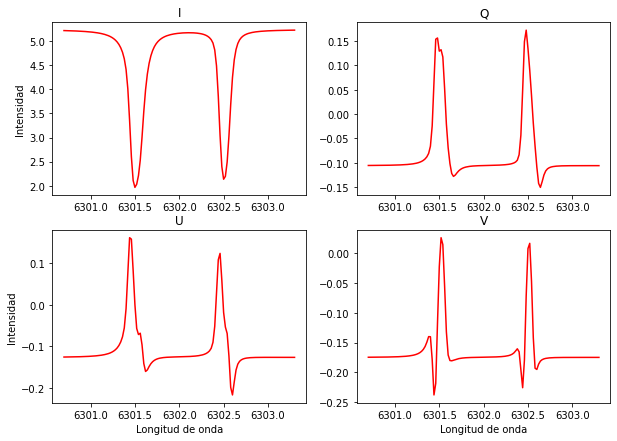

In [ ]:
plt.figure(figsize=[10,7])
plt.subplot(221)
plt.plot(wavelength,I_longi,color="red")
plt.title("I")
plt.ylabel("Intensidad")
plt.subplot(222)
plt.plot(wavelength,Q_longi,color="r")
plt.title("Q")
plt.subplot(223)
plt.plot(wavelength,U_longi,color="r")
plt.title("U")
plt.xlabel("Longitud de onda")
plt.ylabel("Intensidad")
plt.subplot(224)
plt.plot(wavelength,V_longi,color="r")
plt.title("V")
plt.xlabel("Longitud de onda")
plt.show()

Donde podemos observar que al hacer esta demodulación cuando se realizan las rotaciones se obtienen resultados de luz polarizada.
